# Apartment Rent Dataset Classification

## Objective
Implement a data mining project using the Python machine learning library Spark MLlib to predict rental prices (`price`).  
Only Spark MLlib can be used for machine learning tasks, but non-ML libraries are allowed for other purposes.


## Data Source
[Kaggle: Apartment Rent Data](https://www.kaggle.com/datasets/shashanks1202/apartment-rent-data)
This dataset comprises detailed information on apartment rentals

This dataset comprises detailed information on apartment rentals:

- **Identifiers & Location:**  
  - Unique identifiers (`id`)
  - Geographic details (`address`, `cityname`, `state`, `latitude`, `longitude`)
  - Source of the classified listing (`source`)

- **Property Details:**  
  - Category (`category`)
  - Title (`title`)
  - Description (`body`)
  - Amenities (`amenities`)
  - Number of bathrooms (`bathrooms`)
  - Number of bedrooms (`bedrooms`)
  - Size of the apartment (`square_feet`)

- **Pricing Information:**  
  - Rental price (`price`)
  - Displayed price (`price_display`)
  - Price type (`price_type`)
  - Fee (`fee`)

- **Additional Features:**  
  - Photo availability (`has_photo`)
  - Pets allowed (`pets_allowed`)
  - Currency (`currency`)
  - Time of listing creation (`time`)

## Project Phases
1. **Discover and visualize the data**  
2. **Prepare the data for machine learning algorithms**  
3. **Select and train models**  
4. **Fine-tune the model**  
5. **Evaluate the outcomes**  

> **Note:**  
> You must repeat phases 3, 4, and 5 for at least three different models.

In [88]:
#!/usr/bin/env python3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')

# Load dataset
DATA_PATH = "./data/apartments_for_rent_classified_100K.csv"
df = pd.read_csv(DATA_PATH, delimiter=';', encoding='ISO-8859-1')
df.shape

/tmp/ipykernel_92/1453841023.py:11: DtypeWarning:

Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.



(99492, 22)

# (a) Discover and Visualize the Data


## (a)(1) Analysing The Structure and Content Of The Dataset
This initial exploration helps us understand the structure and content of the dataset.

### Goals
- Understand the structure and type of the data available
- Identify possible strategies to address preprocessing concerns
- Identify data that is not available and what percentage of that feature is missing data
- Determine cardinality of features (i.e the effective uniqueness)

In [89]:
summary = []
for col in df.columns:
    value_counts = df[col].value_counts().head(10)
    top_values = [str(x)[:50] for x in value_counts.index]  # Truncate long values
    summary.append({
        "Column": col,
        "Data Type": str(df[col].dtype),
        "Unique Values": df[col].nunique(),
        "Top 10 frequent Values (desc)": " | ".join(top_values)
    })

summary_df = pd.DataFrame(summary)
display(summary_df)  # Shows nicely

,Column,Data Type,Unique Values,Top 10 frequent Values (desc)
0,id,int64,99408,5508802531 | 5197864265 | 5197858885 | 5197859...
1,category,object,7,housing/rent/apartment | housing/rent/commerci...
2,title,object,58503,Apartment in great location | Apartment in pri...
3,body,object,94503,"When searching for a pet-friendly One-, Two- a..."
4,amenities,object,9827,"Parking | Parking,Storage | Gym,Pool | Pool | ..."
5,bathrooms,float64,16,1.0 | 2.0 | 1.5 | 2.5 | 3.0 | 3.5 | 4.0 | 4.5 ...
6,bedrooms,float64,10,2.0 | 1.0 | 3.0 | 4.0 | 0.0 | 5.0 | 6.0 | 7.0 ...
7,currency,object,1,USD
8,fee,object,2,No | Yes
9,has_photo,object,3,Yes | Thumbnail | No


In [90]:
# Missing data %
pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
missing_values = (df.isnull().sum())/ (df.shape[0]) * 100
missing_values.loc[missing_values > 0].sort_values(ascending=False)

address         92.0164
pets_allowed    60.7325
amenities       16.1259
cityname         0.3035
state            0.3035
bedrooms         0.1246
bathrooms        0.0633
latitude         0.0251
longitude        0.0251
price            0.0010
price_display    0.0010
dtype: float64

In [91]:
# Determine cardinality of features (i.e the effective uniqueness)
categorical_cols = [col for col in df.columns if col not in ['id','longitude','latitude','price','time','title','body','address','square_feet','price_display']]
max_len = max(len(col) for col in categorical_cols)
for col in categorical_cols:
    print(f"{col.ljust(max_len)} :{str(df[col].dtype).ljust(10)} : {str(df[col].nunique()).rjust(10)} unique values")

category     :object     :          7 unique values
amenities    :object     :       9827 unique values
bathrooms    :float64    :         16 unique values
bedrooms     :float64    :         10 unique values
currency     :object     :          1 unique values
fee          :object     :          2 unique values
has_photo    :object     :          3 unique values
pets_allowed :object     :          4 unique values
price_type   :object     :          3 unique values
cityname     :object     :       2979 unique values
state        :object     :         51 unique values
source       :object     :         25 unique values


In [92]:
# Check if text fields and identifiers have duplicates
for col in ["id", "title", "body"]:
    print(f"{col} has duplicates: {df[col].duplicated().any()}")


id has duplicates: True
title has duplicates: True
body has duplicates: True


## (a)(2) Results of Analysis of the Structure and Content of Each Column

### Missing Values Analysis
There are missing values in the dataset, most notably for `address` where **92% of the values are missing**.

### Cardinality Assessment
We define **high cardinality** as a feature having more than 20 unique values. Looking at categorical features, we encounter significant cardinality issues:

| Feature | Unique Values | Category | Issue Level |
|---------|---------------|----------|-------------|
| `amenities` | 9,827 | Very High | ⚠️ Critical |
| `cityname` | 2,979 | Very High | ⚠️ Critical |
| `source` | ~50+ | High | ⚠️ Moderate |
| `state` | ~50 | High | ⚠️ Moderate |

**Impact**: High cardinality features can lead to:
- Sparse feature matrices after one-hot encoding
- Overfitting due to too many dimensions
- Poor model generalization

### Duplicate Values Detection
Duplicate values found in:
- **Identifiers**: `id` field has duplicates
- **Free text fields**: Both `title` and `body` contain duplicates

---

## Analyzing The Distribution Of Values in The Dataset

### Analysis Methods
- **Bar graphs** of categorical features
- **Box plots** of numeric features  
- **Histograms** of numeric features

### Objectives
- 🎯 **Identify outliers** in numerical data
- 📊 **Examine statistics** of numerical features (ranges, min/max values)
- 📈 **Assess data distribution** - determine if values are well-spread or skewed

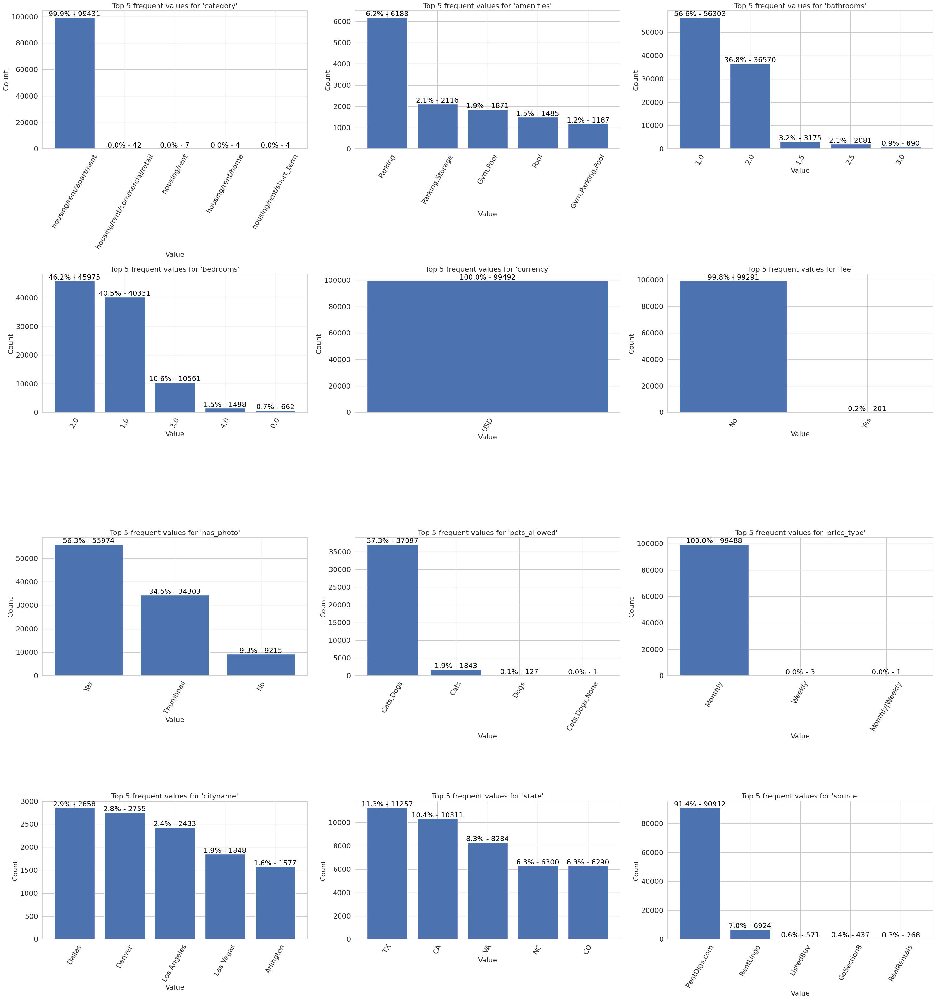

In [93]:
"""
Visualize the distribution of features in the dataset.
Also shows the percentage of the dataset that each value represents.
Only the top 5 most frequent values for each feature are plotted.
**This ignores null values, there are features where most of the values are null
"""

import math
# The following columns are ignored
columns_to_plot = [col for col in df.columns if col not in [
    'id', # Unique identifier, not useful for plotting
    'body', 'title', 'address', # Free text field
    'latitude', 'longitude', # GPS exact values, not useful for plotting
    'time','square_feet','price','price_display' # Numeric fields, not categorical
    ]]
num_cols = len(columns_to_plot)
cols_per_row = 3  # Fewer columns per row for more space
num_rows = math.ceil(num_cols / cols_per_row)

fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(cols_per_row*10, num_rows*8))
axes = axes.flatten()

for i, col in enumerate(columns_to_plot):
    value_counts = df[col].value_counts().head(5)
    total = len(df)
    unique_count = df[col].nunique()
    # Use a colormap for more colorful bars
    bars = axes[i].bar(value_counts.index.astype(str), value_counts.values)
    axes[i].set_title(f"Top 5 frequent values for '{col}'", fontsize=16)
    axes[i].set_xlabel("Value",fontsize=16)
    axes[i].set_ylabel("Count", fontsize=16)
    axes[i].tick_params(axis='x', rotation=60, labelsize=16)
    axes[i].tick_params(axis='y', labelsize=16)
    for bar, count in zip(bars, value_counts.values):
        percent = 100 * count / total
        axes[i].text(bar.get_x() + bar.get_width()/2, bar.get_height(), f"{percent:.1f}% - {count}",
                     ha='center', va='bottom', fontsize=16, color='black')

# Hide any unused subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

/opt/conda/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/opt/conda/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/opt/conda/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/opt/conda/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



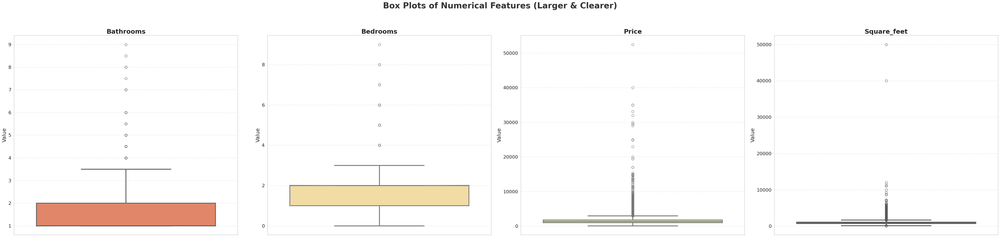

In [94]:
# Identifying outliers with larger, clearer boxplots

import matplotlib.pyplot as plt
import seaborn as sns

float_cols = ["bathrooms", "bedrooms", "price", "square_feet"]

sns.set(style="whitegrid", font_scale=1.5)
num_cols = len(float_cols)
fig, axes = plt.subplots(1, num_cols, figsize=(12*num_cols, 12), sharey=False)

for i, col in enumerate(float_cols):
    sns.boxplot(
        y=df[col],
        ax=axes[i],
        color=sns.color_palette("Spectral", num_cols)[i],
        notch=True,
        linewidth=3,
        fliersize=8,
        boxprops=dict(alpha=0.9)
    )
    axes[i].set_title(f"{col.capitalize()}", fontsize=22, weight='bold')
    axes[i].set_xlabel("")
    axes[i].set_ylabel("Value", fontsize=18)
    axes[i].grid(axis='y', linestyle='--', alpha=0.5)
    axes[i].tick_params(axis='y', labelsize=16)
    axes[i].tick_params(axis='x', labelsize=16)

plt.suptitle("Box Plots of Numerical Features (Larger & Clearer)", fontsize=28, weight='bold', color='#333333')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

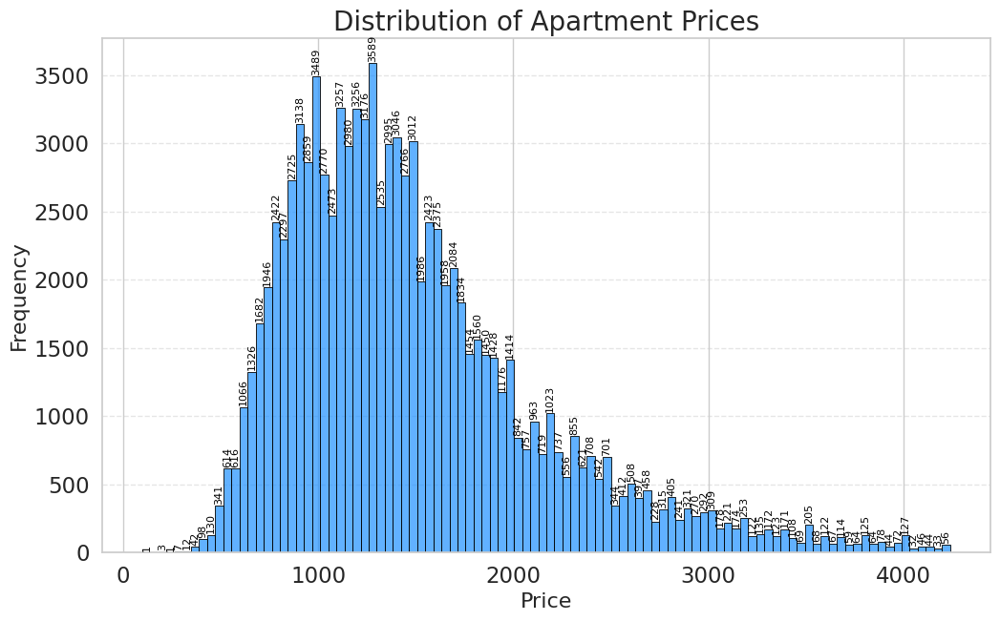

Price histogram: 98482 rows, 3298 unique prices
--------------------------------------------------
Price Statistics
count   99,491.00
mean     1,527.06
std        904.25
min        100.00
25%      1,013.00
50%      1,350.00
75%      1,795.00
max     52,500.00
Name: price, dtype: float64


In [95]:
# Histogram for price excluding outliers
pd.set_option('display.float_format', lambda x: f'{x:,.2f}')
# Exclude outliers (5 std from mean)
mean_price = df['price'].mean()
std_price = df['price'].std()
lower_bound = mean_price - 3 * std_price
upper_bound = mean_price + 3 * std_price
price_histogram = df[(df['price'] >= lower_bound) & (df['price'] <= upper_bound)].copy(deep=True)


plt.figure(figsize=(12, 7))
ax = sns.histplot(
    price_histogram['price'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Prices', fontsize=20)
ax.set_xlabel('Price', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() +10),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

print(f"Price histogram: {len(price_histogram)} rows, {price_histogram['price'].nunique()} unique prices")
print('-' * 50)
print(f"Price Statistics")
print(df['price'].describe())

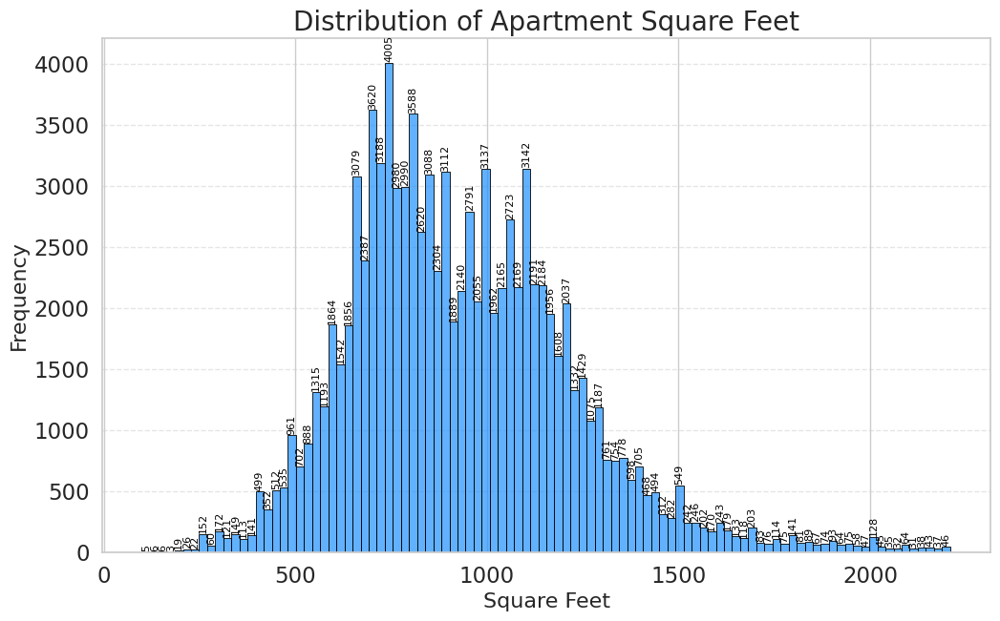

Square feet histogram: 98420 rows, 1875 unique square feet values
--------------------------------------------------
Square Feet Statistics
count   99,492.00
mean       956.43
std        417.57
min        101.00
25%        729.00
50%        900.00
75%      1,115.00
max     50,000.00
Name: square_feet, dtype: float64


In [96]:
# Histogram for square feet excluding outliers

# Exclude outliers (3 std from mean)
mean_sqft = df['square_feet'].mean()
std_sqft = df['square_feet'].std()
lower_bound = mean_sqft - 3 * std_sqft
upper_bound = mean_sqft + 3 * std_sqft
square_feet_histogram = df[(df['square_feet'] >= lower_bound) & (df['square_feet'] <= upper_bound)].copy(deep=True)

# graph
plt.figure(figsize=(12, 7))
ax = sns.histplot(
    square_feet_histogram['square_feet'].dropna(),
    bins=100,
    color='dodgerblue',
    edgecolor='black',
    alpha=0.7
)
ax.set_title('Distribution of Apartment Square Feet', fontsize=20)
ax.set_xlabel('Square Feet', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.grid(axis='y', linestyle='--', alpha=0.5)

# Annotate each bin with its count, with more vertical separation
for patch in ax.patches:
    if patch.get_height() > 0:
        ax.annotate(
            f'{int(patch.get_height())}',
            (patch.get_x() + patch.get_width() / 2, patch.get_height() + 5),
            ha='center', va='bottom', fontsize=8, color='black', rotation=90
        )

plt.show()

# stats
print(f"Square feet histogram: {len(square_feet_histogram)} rows, {square_feet_histogram['square_feet'].nunique()} unique square feet values")
print('-' * 50)
print(f"Square Feet Statistics")
print(df['square_feet'].describe())

## Summary of Data Quality Issues and Preprocessing Concerns

### 🔍 **Duplicate Data Issues**
- **`id`** - Contains duplicate identifiers that need investigation
- **`title`, `body`** - Free text fields with duplicates; need to determine if these are legitimate listings or cross-platform duplicates from different `source` sites

### ⚖️ **Highly Skewed Features (Low Information Value)**
Features dominated by a single value (~90%+ of data):
- **`category`** - 99.4% are "housing/rent/apartment"
- **`currency`** - 100% are USD
- **`fee`** - 99.8% are "No"
- **`price_type`** - 99.9% are "Monthly" 
- **`source`** - 91.4% are from "RentDigs.com"

*Impact: These features provide minimal predictive power due to lack of variance*

### 🎯 **Extreme Outliers**
Numerical features with extreme values requiring treatment:
- **`price`** - Rental prices with unrealistic extremes
- **`square_feet`** - Property sizes with outliers
- **`bedrooms`** - Bedroom counts with extreme values
- **`bathrooms`** - Bathroom counts with extreme values

### 🗂️ **High Cardinality Features**
Features requiring dimensionality reduction:
- **`amenities`** - 9,827 unique values (combinatorial explosion)
- **`cityname`** - 2,979 unique cities

### ❌ **Missing Data**
Features with significant missing values:
- **`address`** - 92% missing (can be safely dropped)
- **`pets_allowed`** - 60.7% missing (impute as "None allowed")
- **`amenities`** - 16% missing (impute as "None provided")

### 🔧 **Processing Requirements**
- **`price_display`** - Redundant formatting of `price`, safe to drop
- **`currency`** - All USD, safe to drop
- **`title`, `body`** - Text features need processing or exclusion
- **`latitude`, `longitude`** - Raw coordinates require transformation for usefulness
- **Categorical features** - Require multi-value binarization (one-hot encoding)

### 📈 **Rare Categories**
- **`price_type`**, **`pets_allowed`** - Contain single-occurrence values that may cause issues

---

*These issues will be systematically addressed during data preparation and feature engineering phases.*

In [97]:
# Geographical map
# Prepare data for mapping
geo_df = df.copy(deep=True)
geo_df = geo_df.dropna(subset=['latitude', 'longitude', 'price'])
geo_df["address"] = geo_df["address"].fillna('Not available')


fig = px.scatter_mapbox(
    geo_df,
    lat="latitude",
    lon="longitude",
    color="price",
    size="price",
    hover_name="title",
    hover_data=["address", "category", "source","state","cityname"],
    mapbox_style="carto-positron",
    zoom=3,
    color_continuous_scale=px.colors.sequential.Plasma,
    title="Geological Map of Apartment Prices"
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

/tmp/ipykernel_92/2639109610.py:8: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [98]:
state_names = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas', 'CA': 'California',
    'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware', 'FL': 'Florida', 'GA': 'Georgia',
    'HI': 'Hawaii', 'ID': 'Idaho', 'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa',
    'KS': 'Kansas', 'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland',
    'MA': 'Massachusetts', 'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi', 'MO': 'Missouri',
    'MT': 'Montana', 'NE': 'Nebraska', 'NV': 'Nevada', 'NH': 'New Hampshire', 'NJ': 'New Jersey',
    'NM': 'New Mexico', 'NY': 'New York', 'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio',
    'OK': 'Oklahoma', 'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah', 'VT': 'Vermont',
    'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia', 'WI': 'Wisconsin', 'WY': 'Wyoming'
}

# Calculate median price per state
state_prices = df.groupby('state')['price'].median().sort_values()

# Get top 5 least and top 5 most expensive states
least_expensive = state_prices.head(5)
most_expensive = state_prices.tail(5)

# Combine for plotting
contrast_states = pd.concat([least_expensive, most_expensive]).reset_index()
contrast_states['State Name'] = contrast_states['state'].map(state_names)
contrast_states['Group'] = ['Least Expensive']*5 + ['Most Expensive']*5

fig = px.bar(
    contrast_states,
    x='price',
    y='State Name',
    color='Group',
    orientation='h',
    text='price',
    color_discrete_map={'Least Expensive': 'teal', 'Most Expensive': 'red'},
    title='Top 5 Least vs Most Expensive States (Median Apartment Price)'
)
fig.update_traces(texttemplate='$%{text:,.0f}', textposition='inside')
fig.update_layout(
    xaxis_title='Median Price (USD)',
    yaxis_title='State',
    yaxis=dict(categoryorder='total ascending'),
    legend_title='',
    font=dict(size=14),
)
fig.show()

In [99]:
# Get visualization of top 5 states with the most listings
top_states = df["state"].value_counts().head(10).reset_index()
top_states.columns = ['state', 'count']  # Rename columns for clarity
top_states["state_name"] = top_states["state"].map(state_names)
fig = px.bar(
    top_states,
    x='count',
    y='state_name',
    orientation='h',
    title='Top 10 States with the Most Listings'
)
fig.update_layout(
    xaxis_title='Number Of Listings',
    yaxis_title='State Name',
    yaxis=dict(categoryorder='total ascending')
)
fig.show()

In [100]:
# Analysing how prices change over time per state (time intervals are in months)
df["time_readable"] = pd.to_datetime(df["time"], unit='s')
df["month"] = df["time_readable"].dt.to_period("M").astype(str)
top_states = df['state'].value_counts().head(10).index

# Group by state and month, get median price and count
plot_df = (
    df[df['state'].isin(top_states)]
    .groupby(['state', 'month'])
    .agg(price=('price', 'median'), count=('price', 'size'))
    .reset_index()
)

fig = px.line(
    plot_df,
    x='month',
    y='price',
    color='state',
    markers=True,
    title='Median Apartment Price by Month (Top 10 States)',
    labels={'month': 'Month', 'price': 'Median Price', 'state': 'State'},
    custom_data=['count']  # Set custom data here for hovertemplate
)

# Add sample count as hover info
fig.update_traces(
    hovertemplate=''
    '<b>%{x}</b>'
    '<br>Median Price: $%{y:,.0f}'
    '<br>Samples: %{customdata[0]}'
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()
# Investigating why california rose so much in this month
print(f"Sudden Spike in November for CA:")
print(
    df.loc[
        (df["month"] == "2019-11") &
        (df["state"] == "CA")
    ]["price"]
)


df.drop(["time_readable","month"],axis=1,inplace=True)
# Conclusion:
# State prices are mostly stable throughout the year in which this data was recorded

Sudden Spike in November for CA:
7123    9,450.00
51779     850.00
Name: price, dtype: float64


# (b) Prepare the data for machine learning algorithms

We will use pandas for quick data exploration or analysis when required but the data is being preprocessed in spark
### Goals
- Remove errors, inconsistencies and duplicates in the dataset
- Address outliers in data
- Handle missing values properly
- Drop features that are either uninformative or redundant
- Convert categorical and textual data into usable numerical formats
- Reduce cardinality and skewed features
- Ensure all data is in a suitable format for machine learning algorithms

In [115]:
# Initialize spark
from pyspark.ml.feature import RFormula
from pyspark.sql import SparkSession
import psutil

# Get M1 Pro specs
total_memory = psutil.virtual_memory().total // (1024**3)  # GB
cpu_cores = psutil.cpu_count()
print(f"M1 Pro detected: {total_memory}GB RAM, {cpu_cores} CPU cores")

spark = SparkSession.builder \
    .appName("CSCI316-Task2-M1-Optimized") \
    .config("spark.driver.memory", f"{min(total_memory-4, 16)}g") \
    .config("spark.driver.maxResultSize", "4g") \
    .config("spark.executor.memory", f"{min(total_memory-6, 12)}g") \
    .config("spark.executor.cores", str(min(cpu_cores-2, 6))) \
    .config("spark.default.parallelism", str(cpu_cores * 2)) \
    .config("spark.sql.adaptive.enabled", "true") \
    .config("spark.sql.adaptive.coalescePartitions.enabled", "true") \
    .config("spark.serializer", "org.apache.spark.serializer.KryoSerializer") \
    .getOrCreate()
# Check Spark UI URL and enable logging
print(f"Spark UI URL: {spark.sparkContext.uiWebUrl}")
print(f"Spark App ID: {spark.sparkContext.applicationId}")
print(f"Spark Master: {spark.sparkContext.master}")

# Enable more verbose logging for better progress tracking
spark.sparkContext.setLogLevel("INFO")


M1 Pro detected: 7GB RAM, 4 CPU cores
Spark UI URL: http://c31569723dd6:4040
Spark App ID: local-1754927389450
Spark Master: local[*]


In [116]:
# Load the data
data = spark.createDataFrame(df)

In [117]:
# Drop redundant columns, dominated/uninformative features
# --------------------------------------------------------
columns_to_drop = []

# Same information as price
if "price_display" in data.columns:
    columns_to_drop.append("price_display")

# All rows are in USD
if "currency" in data.columns:
    columns_to_drop.append("currency")

# Category, 99.9% are housing/rent/apartment, Ignore other values then just drop this column
if "category" in data.columns:
    data = data.filter(data["category"] == "housing/rent/apartment")
    columns_to_drop.append("category")

# Similarly to category, fee is 99.8% No, Ignore other values then just drop this column
if "fee" in data.columns:
    data = data.filter(data["fee"] == "No")
    columns_to_drop.append("fee")

# 91.4% of all sources are RentDigs.com, we can just drop this column then check if there are duplicate listings later on
if "source" in data.columns:
    columns_to_drop.append("source")

# Price_type only has 4 values that is not monthly, Ignore other values, drop the column
if "price_type" in data.columns:
    data = data.filter(data["price_type"] == "Monthly")
    columns_to_drop.append("price_type")

# time just shows when the listing was made, all the listings were recorded in the span of ~1 year
if "time" in data.columns:
    columns_to_drop.append("time")

# has_photo just shows photo availability, not informative for regression task
if "has_photo" in data.columns:
    columns_to_drop.append("has_photo")

# Drop all columns at once
data = data.drop(*columns_to_drop)


In [118]:
# Handle features with missing values
# --------------------------------------------------------

columns_to_drop = []
# Address has 92% missing values,
# The address itself is not very informative even if provided so can safely drop
if "address" in data.columns:
    columns_to_drop.append("address")

# Pets_allowed has 60.7% missing values, means most apartments do not allow pets
# We one hot encode this
from pyspark.sql.functions import explode, split, col, when

data = data.fillna({"pets_allowed": "None"})
data = data.replace("NaN","None",subset=["pets_allowed"])
pets_allowed_list = (
    data.select(explode(split(data.pets_allowed, ",")).alias("pet"))
    .distinct()
    .rdd.flatMap(lambda x: x)
    .collect()
)
for pet in pets_allowed_list:
    if pet == "None":
        continue
    data = data.withColumn(
        f'allows_{pet}',
        when(col('pets_allowed').contains(pet),1).otherwise(0)
    )
columns_to_drop.append("pets_allowed")


# Amenities has 16% missing values, this likely means the absence of amenities, change the null values to instead be "None provided".
# This will be furthere processed later on to handle the high cardinality
data = data.fillna({"amenities": "None provided"})
data = data.replace("","None provided",subset=["amenities"])
data = data.replace("NaN","None provided",subset=["amenities"])



# Other features have less than 1% of values missing we can drop these
data = data.drop(*columns_to_drop)
data = data.na.drop()

# Check if any features still have missing values
pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
check_missing = data.toPandas()
missing_values = (check_missing.isnull().sum())/ (check_missing.shape[0]) * 100
print("features with missing values:", missing_values.loc[missing_values > 0].sort_values(ascending=False))
data.head(1)

features with missing values: Series([], dtype: float64)


[Row(id=5668640009, title='One BR 507 & 509 Esplanade', body='This unit is located at 507 & 509 Esplanade, Redondo Beach, 90277, CAMonthly rental rates range from $2195We have 1 beds units available for rent', amenities='None provided', bathrooms=1.0, bedrooms=1.0, price=2195.0, square_feet=542, cityname='Redondo Beach', state='CA', latitude=33.852, longitude=-118.3759, allows_Dogs=0, allows_Cats=1)]

In [119]:
# Create geographic regions based on latitude and longitude
# --------------------------------------------------------
from pyspark.sql.functions import col, when, percentile_approx
from pyspark.sql import functions as F

# Instead of dropping lat/lon, create regional features
print("Creating geographic regions from latitude and longitude...")

# Calculate geographic boundaries using percentiles
lat_bounds = data.select(
    F.expr("percentile_approx(latitude, 0.33)").alias('lat_33'),
    F.expr("percentile_approx(latitude, 0.67)").alias('lat_67')
).collect()[0]

lon_bounds = data.select(
    F.expr("percentile_approx(longitude, 0.33)").alias('lon_33'),
    F.expr("percentile_approx(longitude, 0.67)").alias('lon_67')
).collect()[0]

lat_33, lat_67 = lat_bounds['lat_33'], lat_bounds['lat_67']
lon_33, lon_67 = lon_bounds['lon_33'], lon_bounds['lon_67']

print(f"Latitude boundaries: {lat_33:.4f}, {lat_67:.4f}")
print(f"Longitude boundaries: {lon_33:.4f}, {lon_67:.4f}")

# Create regions based on geographic quadrants + central zone
data = data.withColumn(
    "resides_in",
    when((col("latitude") >= lat_67) & (col("longitude") <= lon_33), "northwest")
    .when((col("latitude") >= lat_67) & (col("longitude") >= lon_67), "northeast")
    .when((col("latitude") <= lat_33) & (col("longitude") <= lon_33), "southwest")
    .when((col("latitude") <= lat_33) & (col("longitude") >= lon_67), "southeast")
    .otherwise("central")
)

# Show distribution of regions
print("\nRegion distribution:")
data.groupBy("resides_in").count().orderBy("count", ascending=False).show()

# Now drop the original lat/lon columns
data = data.drop(*['latitude','longitude'])

Creating geographic regions from latitude and longitude...
Latitude boundaries: 34.0899, 39.3282
Longitude boundaries: -96.8458, -80.8124

Region distribution:
+----------+-----+
|resides_in|count|
+----------+-----+
|   central|59334|
| southwest|14409|
| northeast|13427|
| northwest|10598|
| southeast| 1252|
+----------+-----+



In [120]:
# Inspect duplicate Ids see if legitimate
# --------------------------------------------------------
duplicate_ids_df = data.toPandas()
duplicate_ids = duplicate_ids_df['id'].value_counts()
duplicate_ids = duplicate_ids[duplicate_ids > 1]
duplicates_different_data = []

# For each id we check if all features are the same value
for i, val in duplicate_ids.items():
    cur = duplicate_ids_df.loc[duplicate_ids_df["id"] == i]
    is_all_same = cur.nunique().eq(1).all()

    # Find columns that have unique values that are not eq(1)
    column_names = []
    if not is_all_same:
        for col,n_unique in cur.nunique().items():
            if n_unique != 1:
                column_names.append((col,n_unique))
        duplicates_different_data.append((i,column_names))
print(f"IDs with different data: ",duplicates_different_data)
# All duplicate ids can be safely dropped.
data = data.dropDuplicates(['id'])

IDs with different data:  []


In [121]:
# Inspect if dataset has complete duplicate listings but only different by source
# --------------------------------------------------------
# The goal is that we just want unique listings in the dataset. Users may have listed their apartments for rent on multiple sources.

from pyspark.sql.functions import col

check_duplicate_listings = data.toPandas()
check_duplicate_listings.set_index("id",inplace=True)
print(f"Any complete duplicates:" ,check_duplicate_listings.duplicated().any())

# Check for listings where the only thing that is different is the title and body
check_duplicate_listings.drop(["title","body"],axis=1,inplace=True)
print(f"Any complete duplicates (without considering title and body):" ,check_duplicate_listings.duplicated().sum())

# Drop these duplicates
duplicate_mask = check_duplicate_listings.duplicated(keep=False)
duplicate_ids = check_duplicate_listings[duplicate_mask].index.unique().tolist()

# Drop in pyspark data
data = data.filter(~col("id").isin(duplicate_ids))

# Drop title and body, will not be using these for prediction
columns_to_drop = ["title","body"]
data = data.drop(*columns_to_drop)

Any complete duplicates: False
Any complete duplicates (without considering title and body): 10169


In [122]:
# High cardinality in amenities
# --------------------------------------------------------
# Amenities has extremely high cardinality as a result of combinatorial explosion (e.g Gym, Pool and Pool, Gym are treated as 2 unique values)
from pyspark.sql.functions import split, explode, when, col, count
from pyspark.sql.types import IntegerType
from pyspark.sql.functions import udf

# Explode the amenities then count them
amenities_exploded = data.select(explode(split(data.amenities, ",")).alias('amenity'))
# Remove "None provided" from the amenities
amenity_counts = (
	amenities_exploded
	.filter(col('amenity') != "None provided")
	.groupBy('amenity')
	.agg(count("*").alias("count"))
	.orderBy('count', ascending=False)
)

# Convert to pandas dataframe
amenities_df = amenity_counts.toPandas()
amenities_df["cumulative_count"] = amenities_df["count"].cumsum()
amenities_df["cumulative_pct"] = amenities_df["cumulative_count"]/amenities_df["count"].sum() * 100
amenities_df["cumulative_pct"] = amenities_df["cumulative_pct"].round(1)

# Get the amenities that account for 90% of all mentions
amenities_90pct = amenities_df.loc[amenities_df["cumulative_pct"] <= 90]
pareto_90_threshold = amenities_90pct["count"].values[-1]  # The minimum count in this group
pareto_90 = len(amenities_90pct)  # Number of amenities

print(f"{pareto_90} amenities out of {amenities_df['amenity'].count()} account for 90% of all mentions")
print(f"Threshold: amenities with >= {pareto_90_threshold} mentions")
print("\nTop amenities that make up 90% of mentions:")
print(amenities_90pct[['amenity', 'count', 'cumulative_pct']])

# Get the list of important amenities
amenity_list = amenities_90pct["amenity"].values.tolist()
# Process the data
for amenity in amenity_list:
    data = data.withColumn(
        f"has_{amenity.lower()}",
        when(col("amenities").contains(amenity), 1).otherwise(0)
    )

# Create a column for "other" amenities (not in amenity_list and not "None provided")
# Prepare amenity_list for comparison (lowercase and stripped)
amenity_set = set([a.strip().lower() for a in amenity_list])

# define a function to handle amenities str
def has_other_amenities(amenities_str):
    if amenities_str == "None provided":
        return 0
    items = [a.strip().lower() for a in amenities_str.split(",")]
    return int(any(a not in amenity_set for a in items))

# declare the udf (user defined function)
has_other_udf = udf(has_other_amenities, IntegerType())

# Apply the udf
data = data.withColumn("has_other", has_other_udf(col("amenities")))
data = data.drop("amenities")

# This results in
# - One hot encoded features for the amenities that account for ~90% of all mentions
# - Rest of the amenities are instead under has_other
# - rows with "None provided" will have all amenity columns as 0 -> implying the absence of amenities
data.head(1)

15 amenities out of 27 account for 90% of all mentions
Threshold: amenities with >= 7650 mentions

Top amenities that make up 90% of mentions:
               amenity  count  cumulative_pct
0                 Pool  35120         11.9000
1              Parking  34909         23.7000
2                  Gym  30232         33.9000
3           Patio/Deck  21700         41.2000
4         Washer Dryer  21328         48.4000
5              Storage  17274         54.3000
6            Clubhouse  15241         59.4000
7           Dishwasher  13450         63.9000
8            Fireplace  12542         68.2000
9                   AC  12341         72.4000
10        Refrigerator  12218         76.5000
11  Cable or Satellite  10162         79.9000
12     Internet Access   9298         83.1000
13          Playground   8495         85.9000
14         Wood Floors   7650         88.5000


[Row(id=5121046540, bathrooms=2.0, bedrooms=2.0, price=1693.0, square_feet=1346, cityname='Atlanta', state='GA', allows_Dogs=0, allows_Cats=0, resides_in='central', has_pool=0, has_parking=1, has_gym=1, has_patio/deck=0, has_washer dryer=0, has_storage=0, has_clubhouse=0, has_dishwasher=0, has_fireplace=0, has_ac=0, has_refrigerator=0, has_cable or satellite=1, has_internet access=1, has_playground=0, has_wood floors=0, has_other=1)]

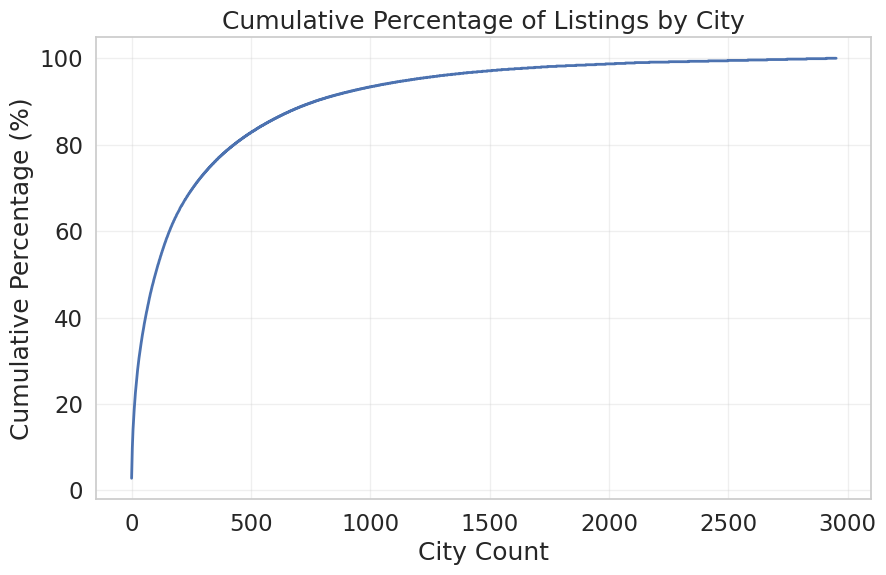

10% coverage requires 4 cities
30% coverage requires 30 cities
50% coverage requires 100 cities
60% coverage requires 159 cities
70% coverage requires 258 cities
80% coverage requires 430 cities
90% coverage requires 770 cities

Get cities that account for 80%, categorize the rest as others


[Row(cityname='other', count=16474),
 Row(cityname='Dallas', count=2272),
 Row(cityname='Denver', count=2220),
 Row(cityname='Los Angeles', count=2163),
 Row(cityname='Atlanta', count=1433),
 Row(cityname='Arlington', count=1328),
 Row(cityname='Las Vegas', count=1136),
 Row(cityname='Charlotte', count=1080),
 Row(cityname='Alexandria', count=819),
 Row(cityname='San Antonio', count=789)]

In [123]:
# High cardinality in cityname
# --------------------------------------------------------
# Get state counts
state_counts = data.groupBy('state').count().orderBy('count',ascending=False)

# Create pandas dataframe with cumulative stats
state_df = state_counts.toPandas()
state_df["cumulative_sum"] = state_df["count"].cumsum()
state_df["cumulative_pct"] = state_df["count"].cumsum() / state_df["count"].sum() * 100
state_df["cumulative_pct"] = state_df["cumulative_pct"].round(1)
state_df = state_df.reset_index().rename(columns={'index':'state_count'})


# Get city counts
city_counts = data.groupBy('cityname').count().orderBy('count', ascending=False)

# Create pandas dataframe with cumulative stats
city_counts_df = city_counts.toPandas()
city_counts_df["cumulative_sum"] = city_counts_df["count"].cumsum()
city_counts_df["cumulative_pct"] = city_counts_df["count"].cumsum() / city_counts_df["count"].sum() * 100
city_counts_df["cumulative_pct"] = city_counts_df["cumulative_pct"].round(1)
city_counts_df = city_counts_df.reset_index().rename(columns={'index':'city_count'})

# Plot cumulative percentage for city only
fig, ax1 = plt.subplots(1, 1, figsize=(10, 6))

# City plot
ax1.plot(city_counts_df["city_count"], city_counts_df["cumulative_pct"], 'b-', linewidth=2)
ax1.set_xlabel("City Count")
ax1.set_ylabel("Cumulative Percentage (%)")
ax1.set_title("Cumulative Percentage of Listings by City")
ax1.grid(True, alpha=0.3)
plt.show()

# Apply pareto analysis to reduce cardinality of citynames
city_counts_df = city_counts_df.reset_index().rename(columns={'index':'city_count'})
N = [10,30,50,60,70,80,90]
for n in N:
    print(f"{n}% coverage requires {city_counts_df.loc[city_counts_df['cumulative_pct'] <= n, 'cityname'].count()} cities")

print(f"\nGet cities that account for 80%, categorize the rest as others")
city_list = city_counts_df.loc[city_counts_df["cumulative_pct"]<=80]["cityname"].values.tolist()
data = data.withColumn(
    'cityname',
    when(col('cityname').isin(city_list), col('cityname')).otherwise('other')
)
data.groupBy('cityname').count().orderBy('count',ascending=False).head(10)

In [124]:
# Outliers in price, bedrooms, bathrooms, price, square_feet
# --------------------------------------------------------
# Use IQR to remove outliers
from pyspark.sql.functions import col, stddev, mean
from pyspark.sql import functions as F

outlier_cols = ["bedrooms","bathrooms","price","square_feet"]
og_count = data.count()
print(f"Before outlier removal, Total rows: {og_count}")

for col_name in outlier_cols:
    quantiles = data.select(
        F.expr(f"percentile_approx({col_name},0.25)").alias('Q1'),
        F.expr(f"percentile_approx({col_name},0.75)").alias('Q3'),
    ).collect()[0]

    Q1 = quantiles["Q1"]
    Q3 = quantiles["Q3"]
    IQR = Q3 - Q1

    # Define outlier bounds
    lower_bound = Q1 - 3 * IQR
    upper_bound = Q3 + 3 * IQR

    print(f"{col_name}: Removing values < {lower_bound:.2f} or > {upper_bound:.2f}")

    data = data.filter(
        (col(col_name) >= lower_bound) &
        (col(col_name) <= upper_bound)
        )
new_count = data.count()
print(f"Before outlier removal, Total rows: {new_count}")
print(f"Removed: {og_count - new_count} rows ({((og_count - new_count) /og_count  * 100):.1f}%)")

Before outlier removal, Total rows: 82429
bedrooms: Removing values < -2.00 or > 5.00
bathrooms: Removing values < -2.00 or > 5.00
price: Removing values < -1354.00 or > 4253.00
square_feet: Removing values < -451.00 or > 2300.00
Before outlier removal, Total rows: 80762
Removed: 1667 rows (2.0%)


In [125]:
# New features
# --------------------------------------------------------
data = data.withColumn(
    "sqft_per_room",
    col("square_feet") / (col("bedrooms") + col("bathrooms") + 0.1)
    )

In [126]:
# New feature using RFormula
# --------------------------------------------------------
from pyspark.ml.feature import RFormula
data= data.drop('id')

# bedrooms:bathrooms -> Interaction term, I want the model to understand that having high num of bedrooms and bathrooms together is highly valued and should be treated as such

# Create new feature using RFormula
rform = RFormula(
    formula="""price ~ . +
    bedrooms:bathrooms +
    bedrooms:square_feet +
    bathrooms:square_feet +
    bedrooms:state +
    bathrooms:state +
    square_feet:state +
    sqft_per_room:state
    """,
    featuresCol="features",
    labelCol="label"
)

# Transform the data
transformed_data = rform.fit(data).transform(data)
# Save transformed data as Parquet
transformed_data.write \
    .mode("overwrite") \
    .parquet("./data/transformed_apartment_data.parquet")

print("Transformed data saved as Parquet!")
transformed_data.toPandas().head(5)

Transformed data saved as Parquet!


,bathrooms,bedrooms,price,square_feet,cityname,state,allows_Dogs,allows_Cats,resides_in,has_pool,...,has_ac,has_refrigerator,has_cable or satellite,has_internet access,has_playground,has_wood floors,has_other,sqft_per_room,features,label
0,2.0000,2.0000,"1,693.0000",1346,Atlanta,GA,0,0,central,0,...,0,0,1,1,0,0,1,328.2927,"(2.0, 2.0, 1346.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0....","1,693.0000"
1,1.0000,2.0000,910.0000,900,other,FL,0,0,central,1,...,0,0,0,0,0,0,0,290.3226,"(1.0, 2.0, 900.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0...",910.0000
2,1.0000,2.0000,999.0000,588,Atlanta,GA,1,1,central,1,...,0,1,1,0,1,0,1,189.6774,"(1.0, 2.0, 588.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0...",999.0000
3,1.0000,1.0000,808.0000,840,other,FL,0,0,central,0,...,0,0,0,0,0,0,0,400.0000,"(1.0, 1.0, 840.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0...",808.0000
4,2.0000,2.0000,"1,003.0000",1078,other,FL,0,0,central,0,...,0,0,0,0,0,0,0,262.9268,"(2.0, 2.0, 1078.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0....","1,003.0000"


# (c) & (d) Select and Train model

We will use pandas for quick data exploration or analysis when required but the data is being preprocessed in spark
### Goals

In [127]:
from pyspark.ml.feature import StandardScaler, VectorAssembler
from pyspark.ml import Pipeline
import os

# Load data
loaded_data = spark.read.parquet("./data/transformed_apartment_data.parquet")
# Split data
train_data, test_data = loaded_data.randomSplit([0.8, 0.2], seed=42)
print(f"Train data: {train_data.count()} rows, Test data: {test_data.count()} rows")

# Scale the entire RFormula 'features' vector for linear models
# Use withMean=False to preserve sparse structure of one-hot encoded features
scaler = StandardScaler(
    inputCol="features",          # RFormula output
    outputCol="scaled_features",
    withStd=True,                 # Scale standard deviation
    withMean=False               # DON'T center around mean (preserves one-hot encoding)
)
scaler_model = scaler.fit(train_data)
scaled_train_data = scaler_model.transform(train_data)
scaled_test_data = scaler_model.transform(test_data)
# Save to load later
scaler_model.write().overwrite().save(os.path.join("./models/scaler"))

# Cache training data in memory for faster access
train_data = train_data.cache()
test_data = test_data.cache()
scaled_train_data = scaled_train_data.cache()
scaled_test_data = scaled_test_data.cache()

print("Data cached for faster repeated access")

Train data: 64766 rows, Test data: 15996 rows
Data cached for faster repeated access


## Model 1: Gradient Boosted Trees (GBT)

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options           | Description                                                                 |
|---------------------|-------------------|-----------------------------------------------------------------------------|
| **maxIter**         | 100, 150, 200     | Number of boosting iterations (trees) in the ensemble                       |
| **maxDepth**        | 6, 8, 10          | Maximum depth of each individual tree                                       |
| **stepSize**        | 0.05, 0.1, 0.15   | Learning rate; how much each tree contributes to the final prediction       |
| **subsamplingRate** | 0.7, 0.8, 0.9     | Fraction of training data randomly sampled for each tree                    |

#### Parameter Details

- **maxIter**: Number of boosting iterations (trees) in the ensemble.  
  *Higher values increase model complexity and training time, but may improve accuracy.*

- **maxDepth**: Maximum depth of each individual tree.  
  *Deeper trees can capture more complex patterns but risk overfitting.*

- **stepSize**: Learning rate, controlling how much each tree contributes to the final prediction.  
  *Lower values make learning more gradual and stable, but require more iterations.*

- **subsamplingRate**: Fraction of training data randomly sampled for each tree.  
  *Lower values introduce more randomness, which can help prevent overfitting and improve generalization.*

> **Note:** This grid search will train 81 parameter combinations. With 3-fold cross-validation, a total of 243 models will be trained. This is computationally intensive.

---

### 🔁 3-Fold Cross Validation

- The dataset is split into 3 equal folds.
- For each run, the model is trained on 2 folds and tested on the remaining fold.
- This process repeats 3 times, each time with a different fold as the test set.
- The final performance metric is the average of the 3 test results.

In [ ]:
from pyspark.ml.regression import GBTRegressor, GBTRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel

# GBT with hyperparameter tuning
gbt = GBTRegressor(
    featuresCol="features",
    labelCol="label",
    predictionCol="prediction",
    seed=42
)

# Hyperparameter grid
# ! Warning: This takes a very long time since it will try all combinations of parameters as well as cross validate them with 3 folds
# ! This will train (3^len(param_grid)) * 3 = 81 parameter combinations * 3 = 243 Models
param_grid = ParamGridBuilder() \
    .addGrid(gbt.maxIter, [100, 150, 200]) \
    .addGrid(gbt.maxDepth, [6, 8, 10]) \
    .addGrid(gbt.stepSize, [0.05, 0.1, 0.15]) \
    .addGrid(gbt.subsamplingRate, [0.7, 0.8, 0.9]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=gbt,
    estimatorParamMaps=param_grid,
    evaluator=RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds=3,
    parallelism=min(cpu_cores-1, 6),
    seed=42
)

model_path = "./models/gbt_regressor"
retrain=True
if not os.path.exists(os.path.join(model_path,"gbt_best_model")) or retrain:
    print("Training GBT with Cross Validation...")
    cv_model = cv.fit(train_data)
    gbt_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained GBT model...")
    gbt_best_model = GBTRegressionModel.load(os.path.join(model_path,"gbt_best_model"))
    print(f"Loaded model with paremeters: ")


print(f"maxIter: {gbt_best_model.getMaxIter()}")
print(f"maxDepth: {gbt_best_model.getMaxDepth()}")
print(f"stepSize: {gbt_best_model.getStepSize()}")
print(f"subsamplingRate: {gbt_best_model.getSubsamplingRate()}")

gbt_train_predictions = gbt_best_model.transform(train_data)
gbt_test_predictions = gbt_best_model.transform(test_data)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")

# Calculate train metrics
train_rmse = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(gbt_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(gbt_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df = pd.DataFrame(performance_data)
print(f"\nGBT Model Performance (Best Parameters):")
print(performance_df)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"gbt_best_model")):
    print(f"Saving the best GBT model to {os.path.join(model_path,'gbt_best_model')}")
    gbt_best_model.write().overwrite().save(os.path.join(model_path,"gbt_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")):
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

Training GBT with Cross Validation...


## Model 2: Linear Regression

### 🔧 Hyperparameter Fine-tuning

| Parameter           | Options              | Description                                                                 |
|---------------------|----------------------|-----------------------------------------------------------------------------|
| **regParam**        | 0.01, 0.1            | L2 regularization parameter (Ridge penalty)                                |
| **elasticNetParam** | 0.5, 1.0             | Elastic net mixing parameter (0=L2, 1=L1, 0.5=balanced)                  |
| **maxIter**         | 100, 200             | Maximum number of iterations for optimization                               |

#### Parameter Details

- **regParam**: L2 regularization parameter to prevent overfitting.  
  *Higher values add more penalty to large coefficients, reducing model complexity.*

- **elasticNetParam**: Controls the balance between L1 (Lasso) and L2 (Ridge) regularization.  
  *0.5 = balanced elastic net, 1.0 = pure Lasso regression (L1 only).*

- **maxIter**: Maximum iterations for the optimization algorithm.  
  *Higher values allow more time for convergence but increase training time.*

> **Note:** Linear regression benefits greatly from feature scaling. We use the scaled features for optimal performance.

---

### 🔁 3-Fold Cross Validation

- Uses scaled features for better convergence and performance
- Tests different regularization strategies to prevent overfitting
- Evaluates on RMSE metric to select the best hyperparameter combination
- This grid search will train 8 parameter combinations (2×2×2) with 3-fold CV = 24 models total

In [ ]:
from pyspark.ml.regression import LinearRegression, LinearRegressionModel
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator, CrossValidatorModel

# Define model
lr = LinearRegression(
    featuresCol = "scaled_features",
    labelCol="label",
    predictionCol="prediction"
)

param_grid = ParamGridBuilder() \
    .addGrid(lr.regParam, [0.01, 0.05 ,0.1]) \
    .addGrid(lr.elasticNetParam,[0.1,0.5,1.0])\
    .addGrid(lr.maxIter, [100,200,500]) \
    .build()

# Cross validation
cv = CrossValidator(
    estimator=lr,
    estimatorParamMaps = param_grid,
    evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction", metricName="rmse"),
    numFolds =3,
    parallelism=min(cpu_cores-1, 6),
    seed = 24
)

model_path = "./models/linear_regressor"
retrain=True
if not os.path.exists(os.path.join(model_path,"lr_best_model")) or retrain:
    print("Training Linear Regression with Cross Validation...")
    cv_model = cv.fit(scaled_train_data)
    lr_best_model = cv_model.bestModel
    print(f"Best parameters found: ")
else:
    print("Loading best pre-trained LR model ...")
    lr_best_model = LinearRegressionModel.load(os.path.join(model_path,"lr_best_model"))

if os.path.exists(os.path.join(model_path,"cv_model")):
    print("Loading CV model...")
    cv_model = CrossValidatorModel.load(os.path.join(model_path,"cv_model"))
    print("Loaded CV model.")

print(f"regParam (L2 penalty): {lr_best_model.getRegParam()}")
print(f"elasticNetParam (L1/L2 mix): {lr_best_model.getElasticNetParam()}")
print(f"maxIter: {lr_best_model.getMaxIter()}")

lr_train_predictions = lr_best_model.transform(scaled_train_data)
lr_test_predictions = lr_best_model.transform(scaled_test_data)

# Calculate train metrics
train_rmse = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "rmse"})
train_mae = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "mae"})
train_r2 = evaluator.evaluate(lr_train_predictions, {evaluator.metricName: "r2"})
# Calculate test metrics
test_rmse = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "rmse"})
test_mae = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "mae"})
test_r2 = evaluator.evaluate(lr_test_predictions, {evaluator.metricName: "r2"})

# Show metrics
performance_data = {
    'Metric': ['RMSE', 'MAE', 'R²', "Sample Size"],
    'Train': [f'{train_rmse:.2f}', f'{train_mae:.2f}', f'{train_r2:.4f}',f'{train_data.count()}'],
    'Test': [f'{test_rmse:.2f}', f'{test_mae:.2f}', f'{test_r2:.4f}',f'{test_data.count()}']
}
performance_df = pd.DataFrame(performance_data)
print(f"\nLR Model Performance (Best Parameters):")
print(performance_df)

# Save the model if doesnt exist
if not os.path.exists(os.path.join(model_path,"lr_best_model")):
    print(f"Saving the best lr model to {os.path.join(model_path,'lr_best_model')}")
    lr_best_model.write().overwrite().save(os.path.join(model_path,"lr_best_model"))
if not os.path.exists(os.path.join(model_path,"cv_model")):
    print(f"Saving the CrossValidator model to {os.path.join(model_path,'cv_model')}")
    cv_model.write().overwrite().save(os.path.join(model_path,"cv_model"))

NameError: name 'cpu_cores' is not defined